### Utilities

In [1]:
import os
from cProfile import label
from itertools import count
import numpy as np
from torch import arange
# from parameters import *
import pickle
import matplotlib.pyplot as plt
import copy
import scipy
import torch
from scipy.stats import entropy
# from sklearn import manifold, decomposition
import math
import csv
# import pandas as pd
from tensorboard.backend.event_processing import event_accumulator
from matplotlib import cm
from scipy.interpolate import interp2d
from scipy.interpolate import RegularGridInterpolator as RGI
import matplotlib.ticker as ticker
import matplotlib.colors as mcolors
from scipy.io import savemat
import scipy.io as scio

def normalization1(data):
    # assert data.shape[0]==900 or data.shape[0]==600 or data.shape[0]==300 or data.shape[0]==120 or data.shape[0]==150
    data = data - np.mean(data, axis=1)[:,np.newaxis]
    data = data/(np.max(np.abs(data), axis=1)[:,np.newaxis]+0.00001)
    data = data - np.min(data)
    data = data/np.max(data)
    return data

# def normalization1(data):
#     assert data.shape[0]==600 or data.shape[0]==300 or data.shape[0]==120
#     data = data - np.min(data)
#     data = data/(np.max(np.abs(data)))
#     return data

def normalization2(data):
    # assert data.shape[0]==900 or data.shape[0]==600 or data.shape[0]==300 or data.shape[0]==120
    data = data - np.mean(data, axis=1)[:,np.newaxis]
    data = data/(np.max(np.abs(data), axis=1)[:,np.newaxis]+0.00001)
    return data


def mean_var(A):
    mean = np.mean(A)
    var = np.var(A)
    std = np.std(A)
    return mean, var, std

def c_mass(data):
    interval = 5
    mass_max = 0
    mass_loc = 0
    for i in range(len(data)-interval):
        if np.sum(data[i:i+interval]) > mass_max:
            mass_max = np.sum(data[i:i+interval])
            mass_loc = i + interval/2
    return (mass_loc, mass_max)

def sorting(base):
    loc_all_0 = []
    for i in base[:, :]:
        loc, mass = c_mass(i)
        loc_all_0.append(loc) 
        # mass_all.append(mass)
    B = np.argsort(loc_all_0)  

    return B

def relu(inX):
    return np.maximum(0,inX)


def cal_TI(h, start=20, end=80, peak_window=4):
    '''
    The peaks are determined by calculating the averaged activities in the *peak_window*.
    '''
    hidden_act = h.T #600,90
    # assert hidden_act.shape[0]==900 or hidden_act.shape[0]==600 or hidden_act.shape[0]==300 or hidden_act.shape[0]==120 or hidden_act.shape[0]==150
    data = relu(normalization2(hidden_act).T) #90,600
    # data = relu(hidden_act.T[20:80,])
    ts = data.shape[0]  # number of time points
    entrpy_bins = end-start
    window_size = 4
    r_threshold = 0

    entrpy_max = entropy(np.ones(entrpy_bins)*data.shape[1]/entrpy_bins)
    # selected_indx = np.nonzero(np.mean(data, axis=0) > r_threshold)[0]
    selected_indx = np.where(np.max(data, axis=0) > r_threshold)[0] # 大于平均发放率的神经元下标
    # selected_indx = np.array(selected_indx).squeeze()
    data = data[:, selected_indx]

    peak_times = np.argmax(data, axis=0) # 峰值时刻
    delay_peak_times = np.argmax(data[start:end,:], axis=0) #延迟时间 最大的发放率的下标
    end_times = np.clip(delay_peak_times + window_size + 1, 0, ts)
    start_times = np.clip(delay_peak_times - window_size, 0, ts)
    # entrpy = entropy(np.histogram(delay_peak_times, entrpy_bins)[0]) 
    entrpy = entropy(np.histogram(delay_peak_times, entrpy_bins)[0]) # 延迟时间的能量
    entrpy_ori = entropy(np.histogram(delay_peak_times, entrpy_bins)[0], base=2)
    # entrpy = entropy(np.histogram(peak_times, entrpy_bins)[0] + 0.1 * np.ones(entrpy_bins))
    r2b_ratio = np.zeros(len(selected_indx)) # 大于平均发放率的神经元比例
    trans_index = 0
    for nind in range(len(selected_indx)):
        # mask = np.zeros(ts)
        # mask[int(start_times[nind]):int(end_times[nind])] = 1
        data0 = data[start:end, nind]
        # ridge = np.mean(data0[int(start_times[nind]):int(end_times[nind])])
        ridge = np.sum(data0[start_times[nind]:end_times[nind]])
        # backgr = np.mean(np.ma.MaskedArray(data0, mask))
        backgr = np.sum(data0)
        # r2b_ratio[nind] = np.log(ridge) - np.log(backgr)
        if backgr == 0:
            r2b_ratio[nind] = 0
        else:
            r2b_ratio[nind] = ridge/backgr #* (end-start)/(end_times[nind]-start_times[nind]) # 窗口期间发放率
        trace_sum = ridge/(end_times[nind]-start_times[nind])
        trans_index += trace_sum

    trans_index /= len(selected_indx)
    entrpy = entrpy / entrpy_max
    r2b_ratio = np.nanmean(r2b_ratio)

    index1 = np.where(peak_times>=start)
    index2 = np.where(peak_times<end)
    index_delay = np.intersect1d(index1[0], index2[0]) # 延迟期间的下标
    trans_len = len(index_delay)/len(selected_indx)
    # transient_index = np.sum(data)/(60*500)
    SI_trial_vec = r2b_ratio + entrpy
    Total = SI_trial_vec + trans_len
    return round(Total, 3), entrpy_ori, entrpy, r2b_ratio, round(SI_trial_vec, 3), trans_index, trans_len

def getMeanTIs(*args, a=20, b=80):
    TIlist = []
    for i in range(len(args)):
        netdir  = args[i]
        results = torch.load(netdir)
        hidden_act = results['hidden_act']
        tis = [cal_TI(hidden_act[:,sample_id,:], a, b)[0] 
               for sample_id in range(hidden_act.shape[1])]
        TIlist.append(np.mean(tis))
    return TIlist
    
def sumTI(*args, a=4, b=16):
    TIlist = getTIs(*args, a=4, b=16)
    return np.array(TIlist).mean(), np.array(TIlist).std()/np.sqrt(len(args))
    
def P_value(value1, value2, num=3):
    t_stat, p_value = scipy.stats.ttest_ind_from_stats(value1[0], value1[1], num, value2[0], value2[1], num, equal_var=False)
    print("t-value: ", t_stat)
    print("p-value: ", p_value)

def P_value_raw_data(value1, value2):
    t_stat, p_value = scipy.stats.ttest_ind(value1, value2)
    print("t-value: ", t_stat)
    print("p-value: ", p_value)
    
dirs = os.path.abspath('.') + '/figure'
if not os.path.exists(dirs):
    os.makedirs(dirs)

class Bezier:
    # 输入控制点，Points是一个array,num是控制点间的插补个数
    def __init__(self,Points,InterpolationNum):
        self.demension=Points.shape[1]   # 点的维度
        self.order=Points.shape[0]-1     # 贝塞尔阶数=控制点个数-1
        self.num=InterpolationNum        # 相邻控制点的插补个数
        self.pointsNum=Points.shape[0]   # 控制点的个数
        self.Points=Points
        
    # 获取Bezeir所有插补点
    def getBezierPoints(self,method):
        if method==0:
            return self.DigitalAlgo()
        if method==1:
            return self.DeCasteljauAlgo()
    
    # 数值解法
    def DigitalAlgo(self):
        PB=np.zeros((self.pointsNum,self.demension)) # 求和前各项
        pis =[]                                      # 插补点
        for u in np.arange(0,1+1/self.num,1/self.num):
            for i in range(0,self.pointsNum):
                PB[i]=(math.factorial(self.order)/(math.factorial(i)*math.factorial(self.order-i)))*(u**i)*(1-u)**(self.order-i)*self.Points[i]
            pi=sum(PB).tolist()                      #求和得到一个插补点
            pis.append(pi)            
        return np.array(pis)

def get_files_in_folder(folder_path):
    file_list = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            file_path = os.path.join(root, file)
            file_list.append(file_path)
    return file_list

cmap_list = scio.loadmat('/home/jiashuncheng/code/Trasient/Plot/MyColormaps.mat')
colors = list(cmap_list['mymap'])
cmap = mcolors.LinearSegmentedColormap.from_list('custom_cmap', colors)

### Plotting functions

In [2]:
import torch
import matplotlib.pyplot as plt

def activity_heat_map_max_TI(result_file, batch_sample_range, delay=6, sr=10):
    '''
    Load data from result_file and examine samples from in the batch_sample_range.
    Plot activity heat map from the sample with the largest TI.
    '''
    results = torch.load(result_file)
    n1, n2 = batch_sample_range
    width = 6
    height = 6
    ti_max = 0
    da = 0
    index = 0
    for i in range(n1,n2): # Select the one with the highest TI from the batch
        hidden_act = results['hidden_act'][:,i,:]
        # print(hidden_act.shape)
        data0 = hidden_act
        ti = cal_TI(data0,20,80)
        data0 = normalization1(data0.T)
        B_mylstm = sorting(data0)
        data0 = data0[B_mylstm,:]
        num = len(data0)
        if ti[0] > ti_max:
            da = data0.copy()
            ti_max = ti[0]
            index = i
    print(ti_max, index)
    fig, ax = plt.subplots(figsize=(width, height))
    img = ax.imshow(da, aspect='auto',cmap=cmap,vmin=0.)
    ax.invert_yaxis()
    plt.title(f"TI={ti_max}", fontsize=16)
    plt.xlabel('Steps/100ms', fontsize=16)
    plt.ylabel('Neuron Index', fontsize=16)
    # plt.title('TRNN (4 directions)', fontsize=16)#+ str(epoch) +'\n' +'ACC:' + str(acc))
    cb=plt.colorbar(img)
    cb.set_label("Normalized firing rate",fontdict={'size':16})
    cb.set_ticks([0,0.2,0.4,0.6,0.8,1])
    cb.ax.tick_params(labelsize=16)
    plt.xticks(np.arange(0, sr * (delay + 3), sr), fontsize=16)
    plt.yticks(fontsize=16)
    for ts in [sr, 2 * sr, (2 + delay) * sr]:  # time stamps
        ax.plot([ts, ts], [0, data0.shape[0]], linestyle='--', color='white', linewidth=2)
    ax.set_ylim([0, data0.shape[0]])
    return fig

def animal_activity_heat_map(fr_data, trial, neurons=None, delay=6, sr=4):
    '''
    Plot single trials of animal experiments neuronal firing rate data.
    The *delay* is needed to trim the post-trial data and the *sr* is the sampling rate.
    '''
    t_begin = 2 * sr  # begin of the trial, there's a 3 second baseline, only keep one second
    t_end = (6 + delay) * sr  # end of the trial
    d_begin = 2 * sr  # begin of the delay period after trial begins
    d_end = (2 + delay) * sr  # end of the delay period after trial begins
    peak_window = max(sr / 2, 1)
    width = 6
    height = 6
    fig, ax = plt.subplots(figsize=(width, height))

    if neurons is None:
        hidden_act = fr_data[t_begin:t_end, :, trial]
    else:
        hidden_act = fr_data[t_begin:t_end, neurons, trial]
    data0 = hidden_act
    ti = cal_TI(data0, d_begin, d_end)
    data0 = normalization1(data0.T)
    B_mylstm = sorting(data0)
    data0 = data0[B_mylstm,:]
    num = len(data0)
    
    img = ax.imshow(data0, aspect='auto',cmap=cmap,vmin=0.)
    ax.invert_yaxis()
    ax.set_title(f"TI={ti[0]}", fontsize=16)
    plt.xlabel('Steps/250ms', fontsize=16)
    plt.ylabel('Neuron Index', fontsize=16)
    cb=plt.colorbar(img)
    cb.set_label("Normalized firing rate",fontdict={'size':16})
    cb.set_ticks([0,0.2,0.4,0.6,0.8,1])
    cb.ax.tick_params(labelsize=16)
    plt.xticks(np.arange(0, sr * (delay + 4), sr), fontsize=16)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)

    for ts in [sr, 2 * sr, (2 + delay) * sr]:  # time stamps
        ax.plot([ts, ts], [0, data0.shape[0]], linestyle='--', color='white', linewidth=2)
    ax.set_ylim([0, data0.shape[0]])
    return fig

In [3]:
def activity_heat_maps(result_file, batch_sample_range):
    '''
    Load data from result_file and plot activity heat map of all 
    samples from in the batch_sample_range.
    '''
    results = torch.load(result_file)
    n1, n2 = batch_sample_range
    width = 4 * 4
    height = 6 * 4
    fig, axs = plt.subplots(8, 8, figsize=(width, height))
    for i in range(n1,n2):
        hidden_act = results['hidden_act'][:,i,:]
        # print(hidden_act.shape)
        data0 = hidden_act
        ti = cal_TI(data0,20,80)
        data0 = normalization1(data0.T)
        B_mylstm = sorting(data0)
        data0 = data0[B_mylstm,:]
        num = len(data0)
        axs[i//8][i%8].imshow(data0, aspect='auto',cmap=cmap,vmin=0.)
        axs[i//8][i%8].invert_yaxis()
        axs[i//8][i%8].set_title(f"TI={ti[0]}")
    return fig

def animal_activity_heat_maps(fr_data, trials, neurons=None, delay=6, sr=4):
    '''
    Plot single trials of animal experiments neuronal firing rate data.
    The *delay* is needed to trim the post-trial data and the *sr* is the sampling rate.
    '''
    t_begin = 2 * sr  # begin of the trial, there's a 3 second baseline, only keep one second
    t_end = (6 + delay) * sr  # end of the trial
    d_begin = 2 * sr  # begin of the delay period after trial begins
    d_end = (2 + delay) * sr  # end of the delay period after trial begins
    peak_window = max(sr / 2, 1)
    width = 4 * 4
    height = 6 * 4
    fig, axs = plt.subplots(8, 8, figsize=(width, height))
    for i, t in enumerate(trials):
        if neurons is None:
            hidden_act = fr_data[t_begin:t_end, :, t]
        else:
            hidden_act = fr_data[t_begin:t_end, neurons, t]
        data0 = hidden_act
        ti = cal_TI(data0, d_begin, d_end)
        data0 = normalization1(data0.T)
        B_mylstm = sorting(data0)
        data0 = data0[B_mylstm,:]
        num = len(data0)
        axs[i//8][i%8].imshow(data0, aspect='auto',cmap=cmap,vmin=0.)
        axs[i//8][i%8].invert_yaxis()
        axs[i//8][i%8].set_title(f"TI={ti[0]}")
    return fig

In [4]:
def combined_heat_maps(data_list, t_begin=0, delay=6, sr=4):
    '''
    Plot multiple sample heatmaps in one figure.
    '''
    t_begin = t_begin * sr
    t_end = t_begin + (3 + delay) * sr  # end of the trial
    row, col, width, height = 1, 3, 14, 5
    fig, axs = plt.subplots(row, col, figsize=(width, height))
    for data, ax in zip(data_list, axs):
        data = data[t_begin:t_end, :]
        data0 = normalization1(data.T)
        B_mylstm = sorting(data0)
        data0 = data0[B_mylstm,:]
        ax.imshow(data0, aspect='auto',cmap=cmap,vmin=0.)
        ax.invert_yaxis()
        ax.set_xlabel(f'Steps/{1000//sr}ms', fontsize=16)
        for ts in [sr, 2 * sr, (2 + delay) * sr]:  # time stamps
            ax.plot([ts, ts], [0, data0.shape[0]], linestyle='--', color='white', linewidth=2)
        ax.set_ylim([0, data0.shape[0]])
    axs[0].set_ylabel('Neuron Index', fontsize=16)
    return fig

### Test parameters for patterns and accuracies

- Plot one sample TRNN, trained to 95% accuracy of decision

1.712 30


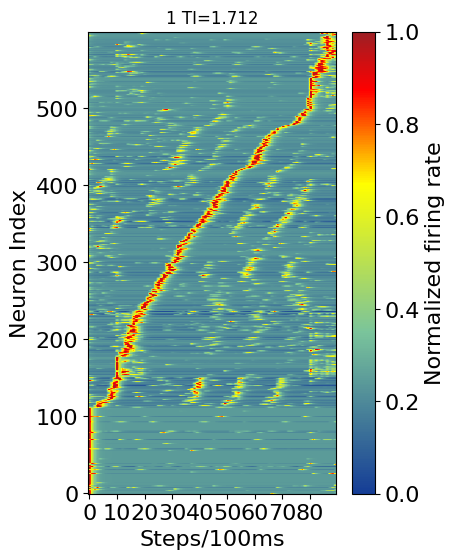

In [19]:
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_True_connection_0.2_region_True_mode_train_delay_6_hidd_600_seed_0_lr0.001_vm4.0_vgamma1.0_alpha0.6/" \
    "20240907164838_model_5000.pt" # trasient_w_regi_conn
fig = activity_heat_map_max_TI(netdir, (0, 32))

- Another sample, RNN, not well trained, decision accuracy around 50%
- This is because of initialization with distances.

0.008 0


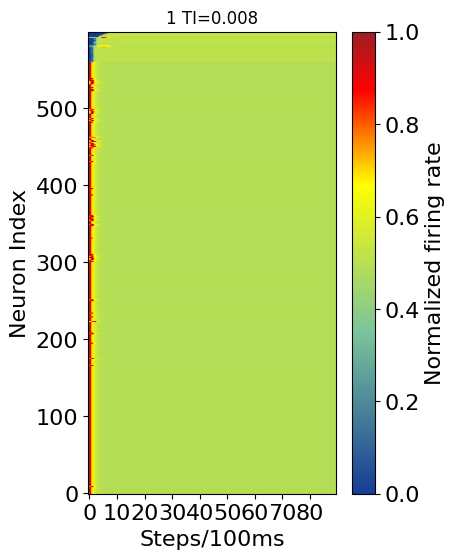

In [10]:
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_hidd_600_seed_0_lr0.001_vm2.0_vgamma2.0_alpha0.6/" \
    "20240907164717_model_5000.pt" # trasient_w_regi_conn
fig = activity_heat_map_max_TI(netdir, (0, 32))

- Another sample, RNN, randomly initialized and well trained, decision accuracy of 100%
- For RNNs, the in_ and out parameters should be set False to disable region specific input and output connection mask.
- Plot all samples from the batch.
- These clearly have much lower TI.

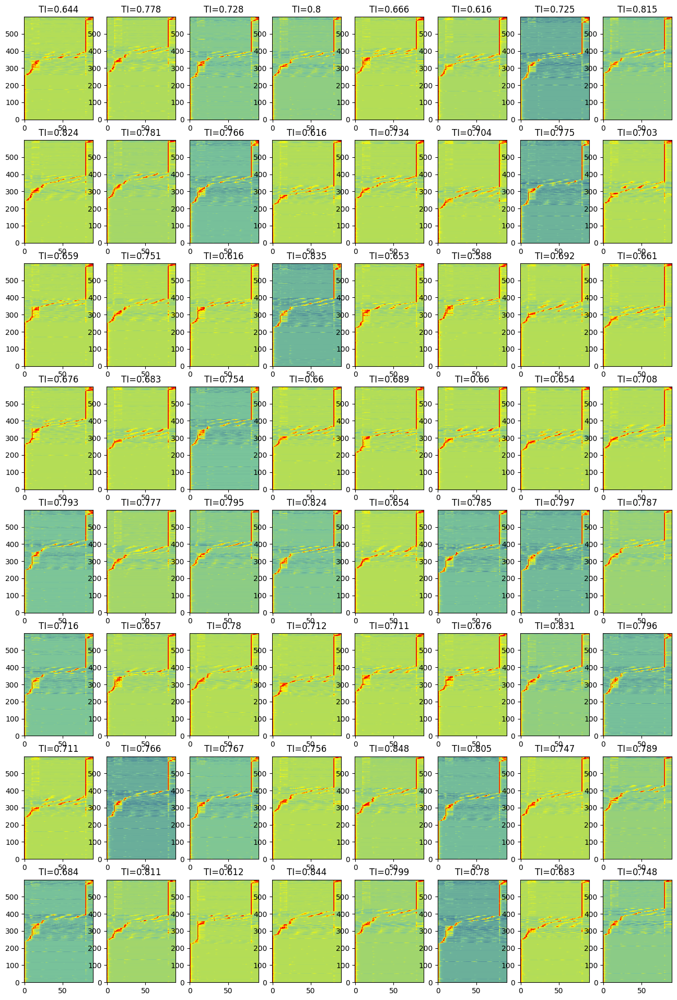

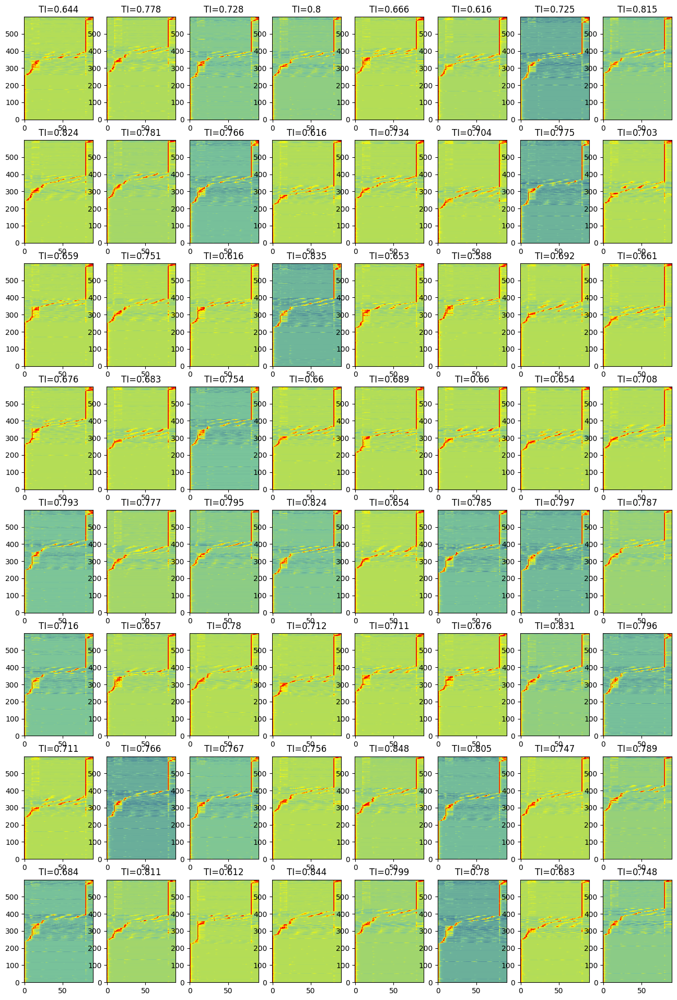

In [25]:
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "no_self_recurrent_exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_hidd_600_seed_5_lr0.001_vm2.0_vgamma2.0_alpha0.6/" \
    "20240908141236_model_5000.pt"
activity_heat_maps(netdir, (0, 64))

- The removing of self recurrent connection doesn't make sense. Try removing it.
- No output from inhibitory neurons also doesn't make sense since the polarity is not enforced. Try removing this.
- The results shows clearer persistent activities of a small group of neurons.

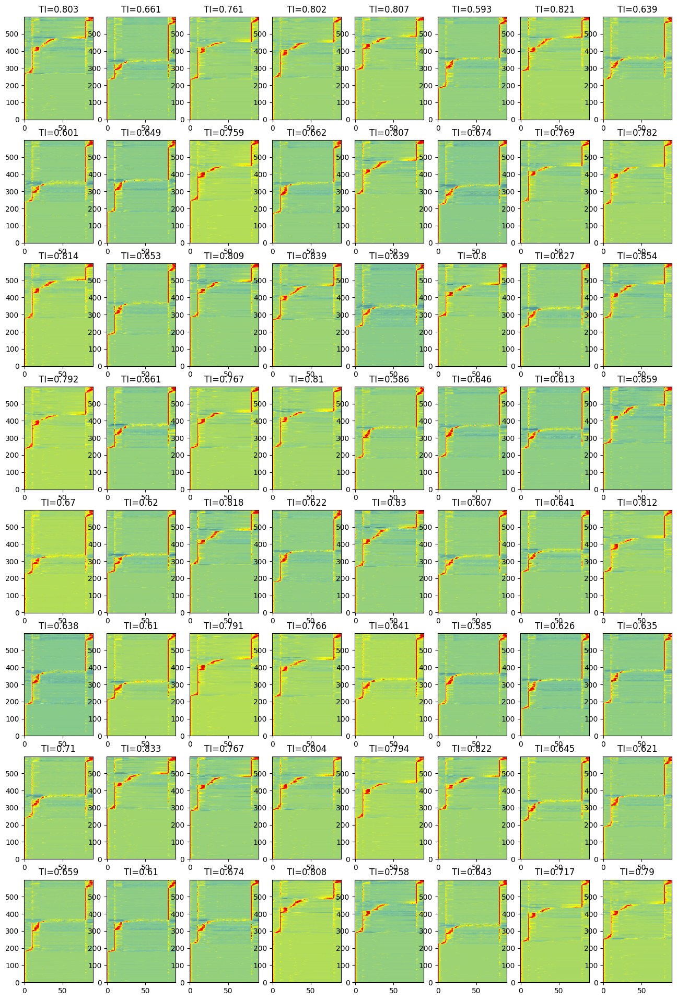

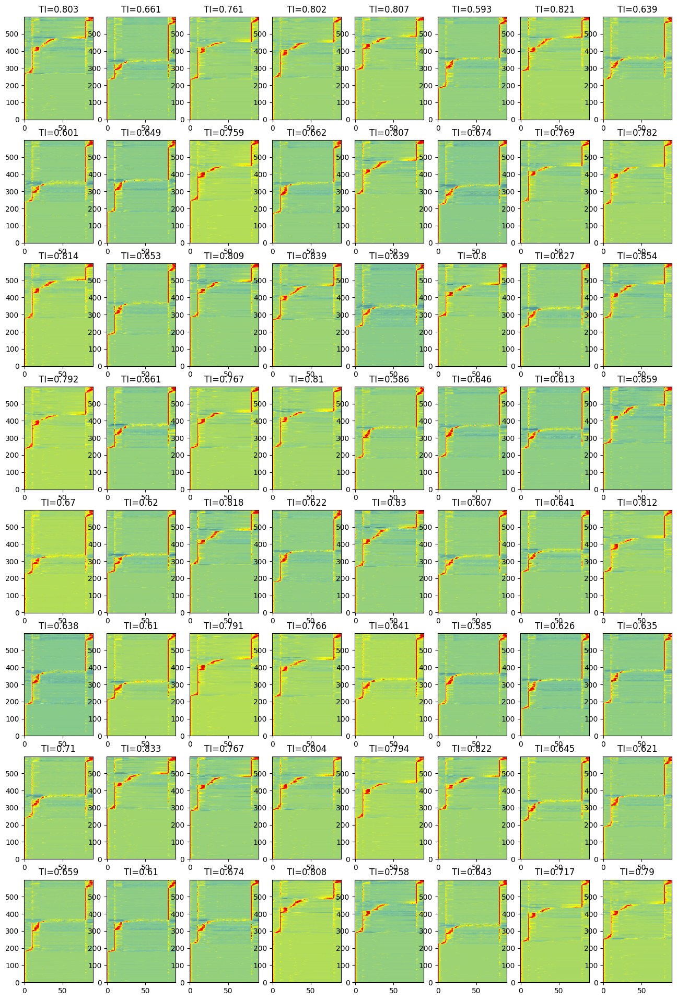

In [28]:
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_hidd_600_seed_5_lr0.001_vm2.0_vgamma2.0_alpha0.6/" \
    "20240908144326_model_1800.pt"
activity_heat_maps(netdir, (0, 64))

- Therefore plan to use this setup as baseline RNN.
- Try TRNN based on this.
- TRNN's decision accuracy cannot get over 0.95. Try lowering the weight decay factor from **0.1** to **0.01**.
- The accuracy is still around 0.95.
- But the transient pattern shows.

1.755 2


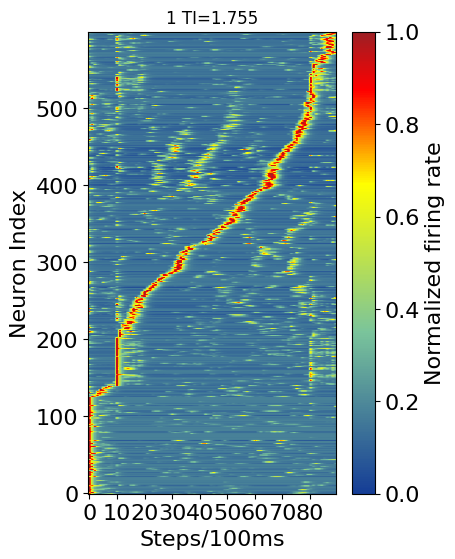

In [30]:
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/TRNN_with_in_out_group_mask/" \
    "exp_repeats_tansient_True_connection_0.2_region_True_mode_train_delay_6_hidd_600_seed_2_lr0.001_vm2.0_vgamma2.0_alpha0.6_weightloss0.01/" \
    "20240908153840_model_1600.pt"
fig = activity_heat_map_max_TI(netdir, (0, 32))

- To increase TRNN accuracy, try removing in-/output neuron group restrictions.
- The TRNN could reach decision accuracy of 1 and the pattern is transient.
- Weight loss regularization factor back to 0.1.

2.027 29


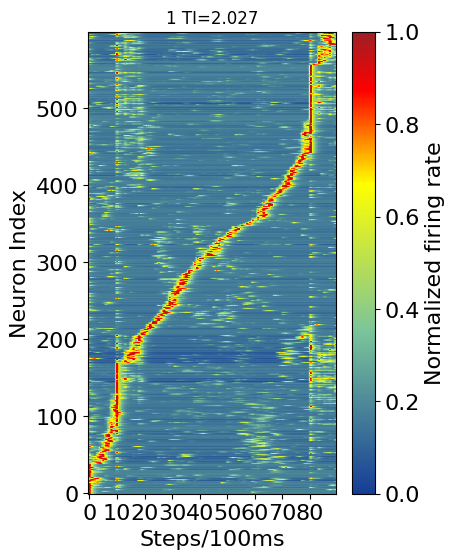

In [32]:
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_True_connection_0.2_region_True_mode_train_delay_6_hidd_600_seed_2_lr0.001_vm2.0_vgamma2.0_alpha0.6/" \
    "20240908160949_model_2000.pt"
fig = activity_heat_map_max_TI(netdir, (0, 32))

- Since these parameters seems to work, try setting alpha to 1 to match the RLs and previous papers showing transient activities in RNN.
- This is in RNN and accuracy of 1 is reached.
- They do seem more transient. Back to alpha of 0.6 then.

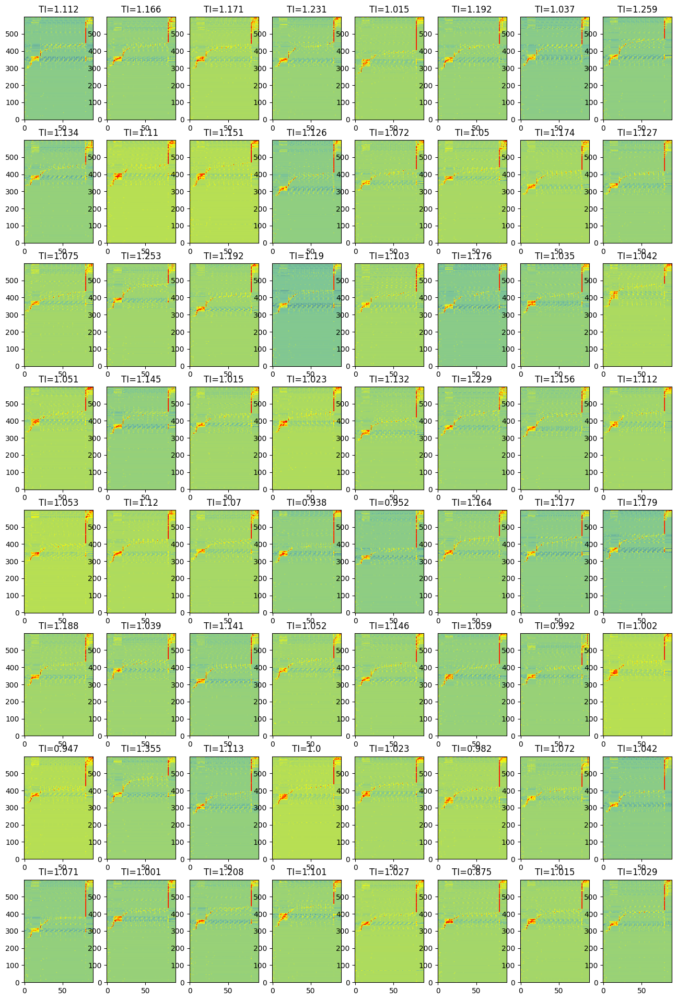

In [37]:
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_hidd_600_seed_2_lr0.001_vm2.0_vgamma2.0_alpha1.0/" \
    "20240908163844_model_5000.pt"
fig = activity_heat_maps(netdir, (0, 64))

- Test the impact of training steps on pattern, since longer training further reduces total activities.
- Compare models trained to lower loss and early-stopped models.
- Lower loss seems to result in more transient activities but there're still other factors of variances.

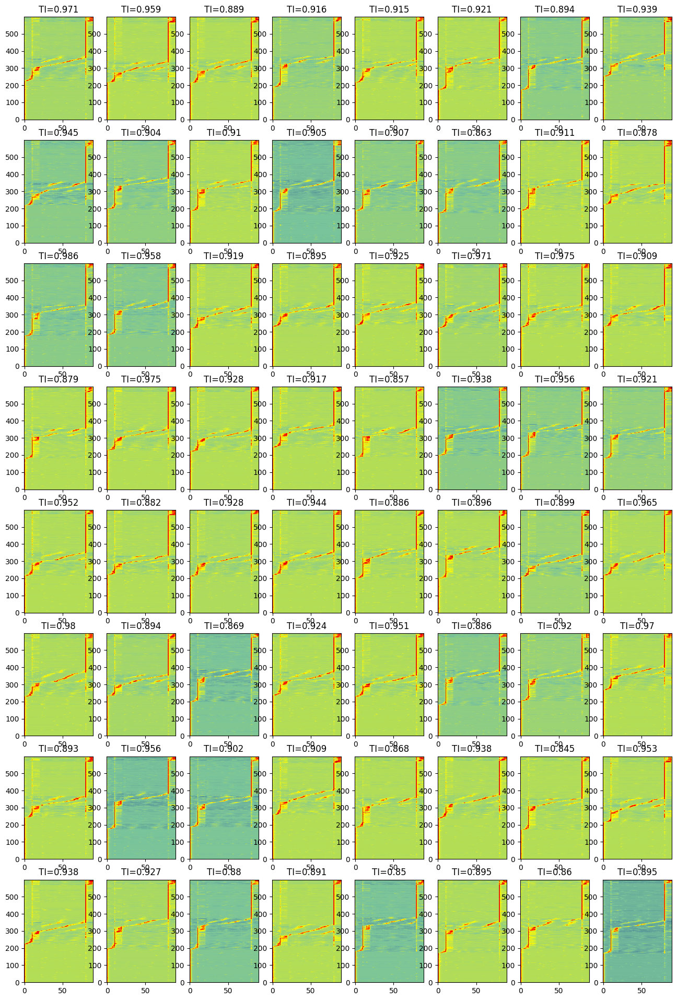

In [38]:
# Trained 2000 steps to loss of 0.0039
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_hidd_600_seed_11_lr0.001_vm2.0_vgamma2.0_alpha0.6_full/" \
    "20240908173029_model_2000.pt"
fig = activity_heat_maps(netdir, (0, 64))

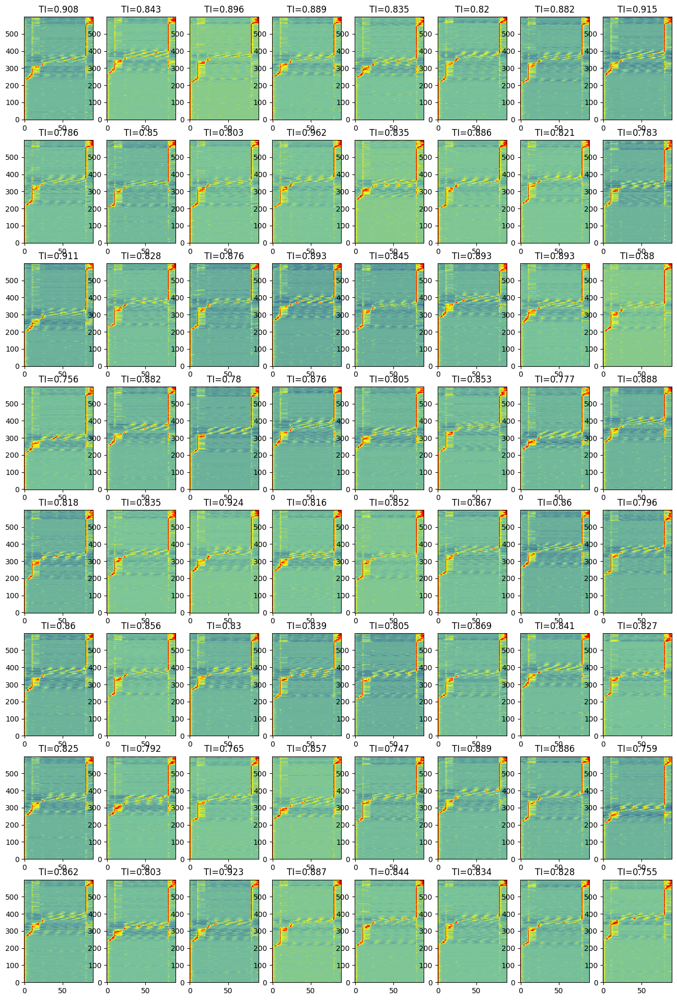

In [39]:
# Trained 1500 steps to loss of 0.0075
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_hidd_600_seed_11_lr0.001_vm2.0_vgamma2.0_alpha0.6_stop0.01/" \
    "20240908174504_model_1500.pt"
fig = activity_heat_maps(netdir, (0, 64))

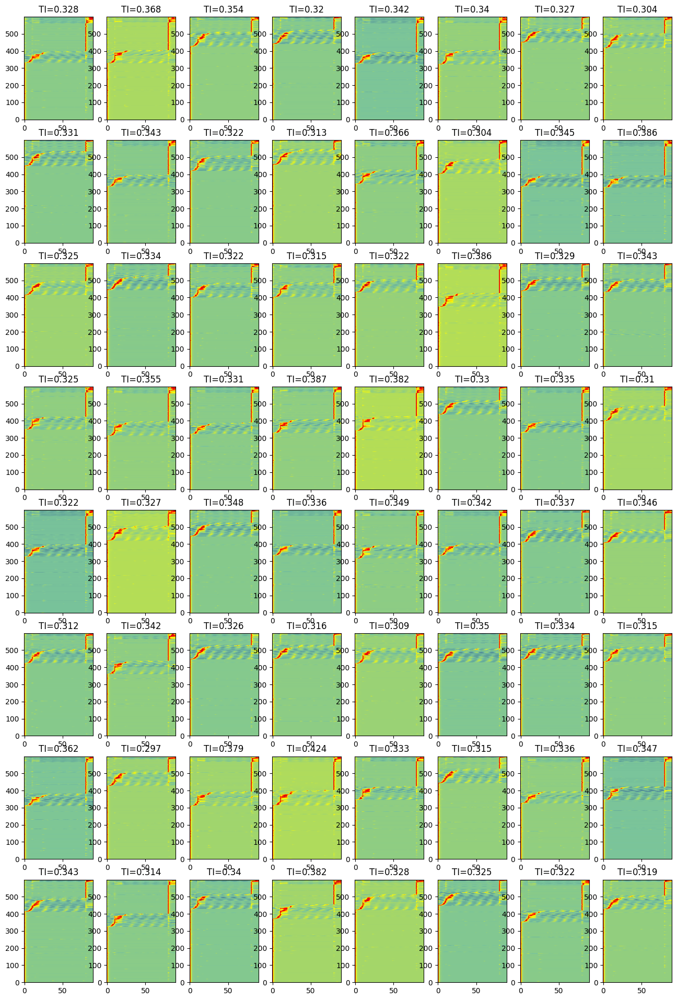

In [40]:
# Trained 3800 steps to loss of 0.0107
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_hidd_600_seed_11_lr0.001_vm2.0_vgamma2.0_alpha0.6_stop0.02/" \
    "20240908175329_model_3800.pt"
fig = activity_heat_maps(netdir, (0, 64))

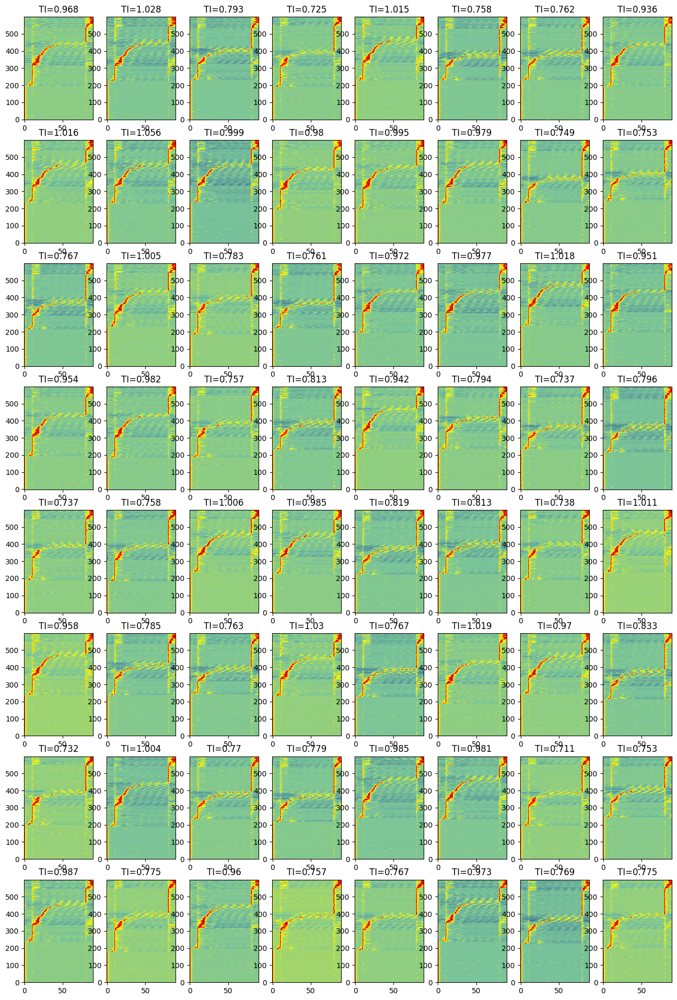

In [41]:
# Trained 700 steps to loss of 0.027
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_hidd_600_seed_11_lr0.001_vm2.0_vgamma2.0_alpha0.6/" \
    "20240908181911_model_700.pt"
fig = activity_heat_maps(netdir, (0, 64))

- Looks like loss threshold of 0.03 is good enough.
- Try one with TRNN to check the patterns and it looks okay.

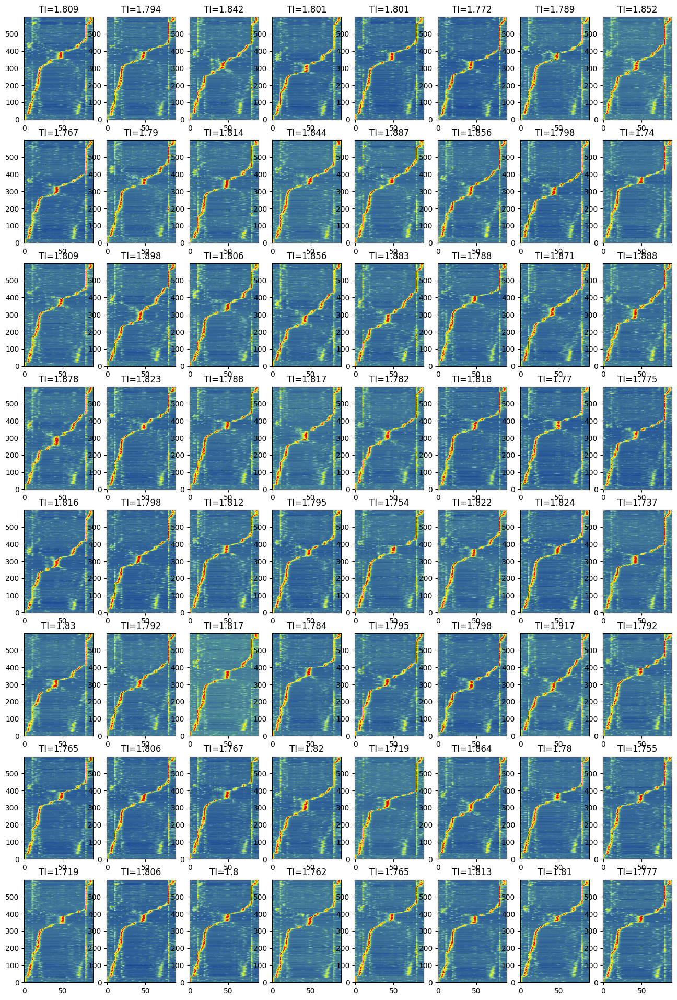

In [42]:
# Trained 600 steps to total loss of 0.0169
netdir  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/" \
    "exp_repeats_tansient_True_connection_0.2_region_True_mode_train_delay_6_hidd_600_seed_11_lr0.001_vm2.0_vgamma2.0_alpha0.6/" \
    "20240908182857_model_600.pt"
fig = activity_heat_maps(netdir, (0, 64))

### Repeating experiments
Ignore one or two modifications. Just compare RNN and TRNN.

In summary, current setup is
- RNN
    - Gamma initialization, but have 20% neurons' outputs time -1.
    - Self recurrent connections are allowed and inhibitory neurons may output to the output layer.
    - Alpha = 0.6.
    - Loss is cross-entropy error plus average hidden neuronal activities with a factor of 0.01.
    - Training stops when loss reaches 0.03.
- TRNN has the same baseline setup as RNN plus
    - Transient neurons, gamma = 2, m = 2.
    - Sparse connections with weight regularization of factor 0.1.
    - Regions separation defined through initialization sparsity (sensory: 0.9, association: 1, motor: 1, cross region: 0.8).
    - The early stopping doesn't consider the weight L2 norm in the loss.

In [5]:
import glob

seeds = [11, 13, 17, 19, 23, 29, 31, 37, 41, 43]
result_folder = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/"
TRNN_folder = "exp_repeats_tansient_True_connection_0.2_region_True_mode_train_delay_6_" \
    "hidd_600_seed_{}_lr0.001_vm2.0_vgamma2.0_alpha0.6"
RNN_folder = "exp_repeats_tansient_False_connection_1.0_region_False_mode_train_delay_6_" \
    "hidd_600_seed_{}_lr0.001_vm2.0_vgamma2.0_alpha0.6"
TRNN_result_files = []
RNN_result_files = []
for s in seeds:
    rt = glob.glob(result_folder + TRNN_folder.format(s) + "/*.pt")
    rr = glob.glob(result_folder + RNN_folder.format(s) + "/*.pt")
    TRNN_result_files += rt
    RNN_result_files += rr
TRNN_TIs = getMeanTIs(*TRNN_result_files, a=20, b=80)
RNN_TIs = getMeanTIs(*RNN_result_files, a=20, b=80)

In [67]:
[TRNN_TIs, RNN_TIs]

[[1.806515625,
  1.891609375,
  1.9006875,
  1.9386406250000001,
  1.362078125,
  1.62134375,
  1.9494531249999998,
  2.01546875,
  1.561328125,
  1.655140625],
 [0.874859375,
  0.7312343749999999,
  0.568265625,
  0.507234375,
  0.372546875,
  0.7560312499999999,
  0.533453125,
  0.653625,
  0.547265625,
  0.5845]]

#### Plot some sample heatmaps

2.033 38


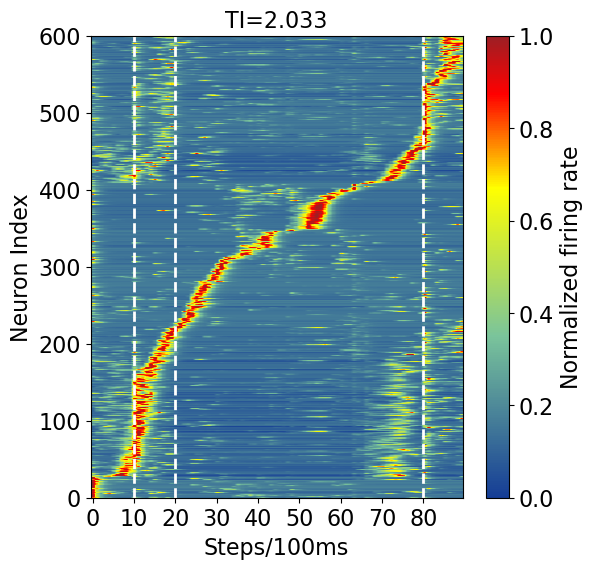

In [83]:
# TRNN
f = TRNN_result_files[6]
fig = activity_heat_map_max_TI(f, (32, 64))
fig.savefig("sample_TRNN.svg")

0.644 44


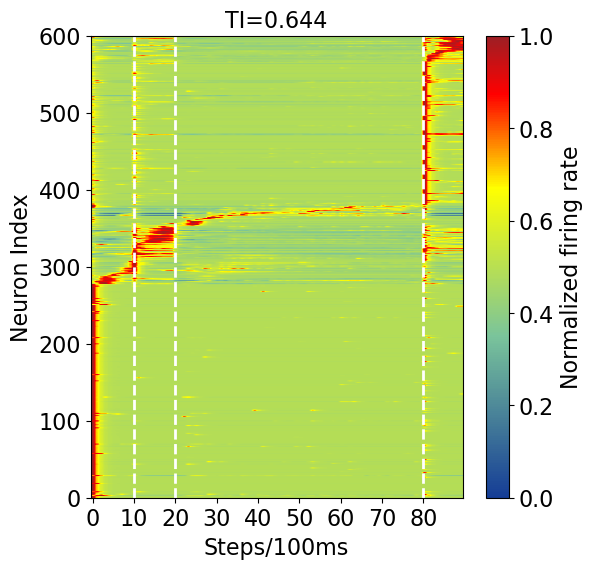

In [84]:
# RNN
f = RNN_result_files[3]
fig = activity_heat_map_max_TI(f, (32, 64))
fig.savefig("sample_RNN.svg")

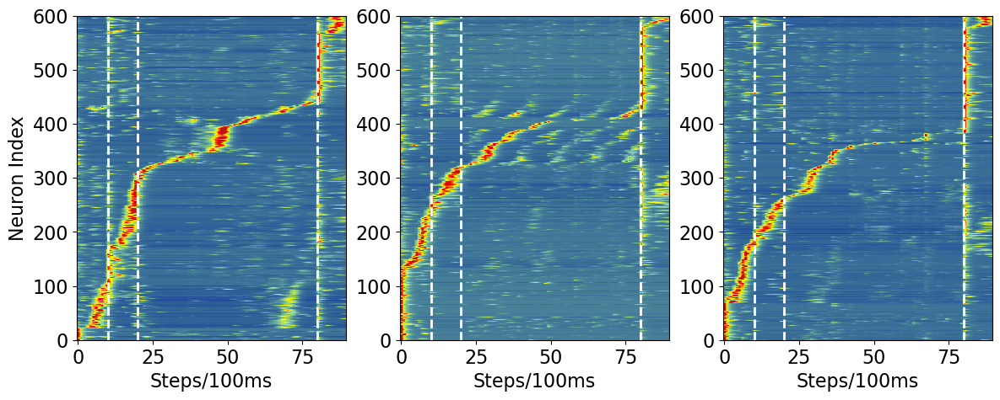

In [141]:
# i is file index and t is batch sample index
data = [torch.load(TRNN_result_files[i])['hidden_act'][:,t,:] 
        for i, t in zip([0, 4, 5], [1, 2, 3])]
f = combined_heat_maps(data, t_begin=0, delay=6, sr=10)
f.savefig("more_TRNN_samples.svg")

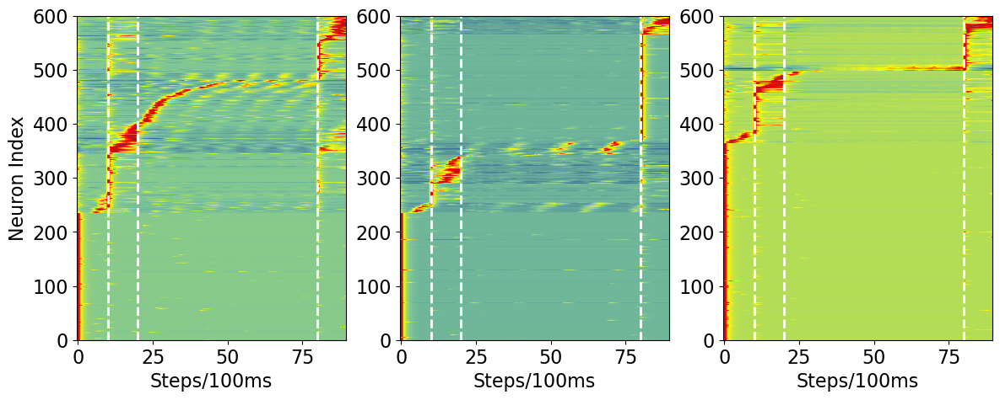

In [142]:
# i is file index and t is batch sample index
data = [torch.load(RNN_result_files[i])['hidden_act'][:,t,:] 
        for i, t in zip([0, 2, 4], [22, 2, 3])]
f = combined_heat_maps(data, t_begin=0, delay=6, sr=10)
f.savefig("more_RNN_samples.svg")

#### Plot model with variable delay

1.774 15


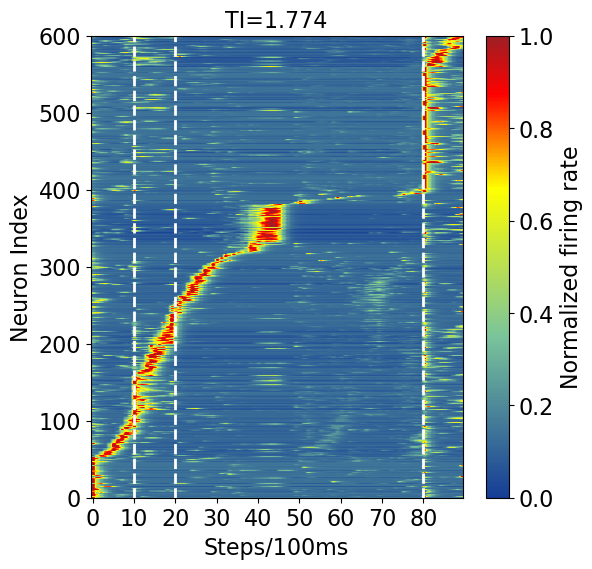

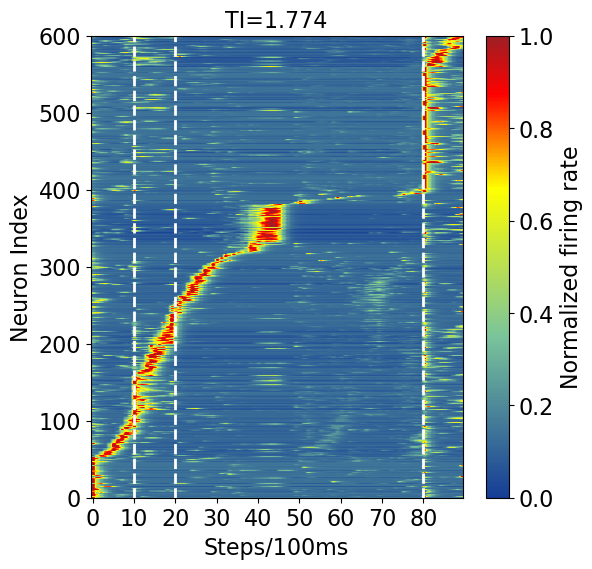

In [62]:
netfolder  = "/home/jiashuncheng/code/Trasient/ODPA/cl_repeat/savedir/standard_RNN/" \
    "exp_repeats_tansient_True_connection_0.2_region_True_mode_test_delay_6_" \
    "hidd_600_seed_11_lr0.001_vm2.0_vgamma2.0_alpha0.6"
netdir = glob.glob(netfolder + "/*.pt")[0]
activity_heat_map_max_TI(netdir, (0, 64))

### Analyzing animal experiments data
- Calculate TIs to compare with models.
- dPCA analysis.

#### Utilities
- /Trials, 10 x n_trial dataset
	1. Col 0: sample odor onset timestamp
	2. Col 1: test odor onset timestamp
	3. Col 4: sample odor (4=s1, 8=s2)
	4. Col 5 test odor (8=t1, 4=t2)
	5. Col 6: 1=lick, -1=no lick
	6. Col 7: delay period (3=3s, 6=6s)

In [12]:
import h5py

In [7]:
def session_accuracy(trials, delay=3):
    trial_n = np.sum(trials[7, :] == delay)
    targets = 1 - 2 * (trials[4, :] - trials[5, :] == 0)
    correct_n = np.sum((trials[6, :] == targets) & (trials[7, :] == delay))
    return correct_n / trial_n

In [8]:
def get_correct_trials(trials, delay=3):
    '''
    Get ids of correct trials.
    '''
    targets = 1 - 2 * (trials[4, :] - trials[5, :] == 0)
    correct_trials = np.nonzero((trials[6, :] == targets) & (trials[7, :] == delay))[0]
    return correct_trials

In [9]:
def animalGetMeanTIs(data_files, delay=6, sr=4, memory_neurons=False):
    TIlist = []
    d_begin = 5 * sr  # begin of the delay period, 3 s baseline + 1 s sample
    d_end = (5 + delay) * sr  # end of the delay period
    for data_file in data_files:
        f = h5py.File(data_file, 'r')
        trials = f['Trials']
        fr_data = f['FR_All']
        correct_trials = get_correct_trials(trials, delay)
        if memory_neurons:
            selective_neurons = get_memory_selective_neurons(trials, fr_data, sr)
            tis = [cal_TI(fr_data[:,selective_neurons,trial_id], d_begin, d_end)[0] 
               for trial_id in correct_trials]
        else:
            tis = [cal_TI(fr_data[:,:,trial_id], d_begin, d_end)[0] 
                   for trial_id in correct_trials]
        TIlist.append(np.mean(tis))
    return TIlist

In [10]:
from scipy import stats

def get_memory_selective_neurons(trials, fr_data, sr=4):
    '''
    Find memory selective neurons by comparing their firing rate data in trials 
    with different stimuli.
    - Compare 1s time windows in sample and delay periods.
    '''
    ts, ps = [], []
    for delay in [3, 6]:
        t_begin = 3 * sr
        t_end = (4 + delay) * sr
        s0_trials = np.nonzero((trials[4, :] == 4) & (trials[7, :] == delay))[0]
        s1_trials = np.nonzero((trials[4, :] == 8) & (trials[7, :] == delay))[0]
        s0_fr = fr_data[t_begin:t_end, :, s0_trials]\
            .reshape(1 + delay, sr, fr_data.shape[1], len(s0_trials))\
            .sum(axis=1) / sr
        s1_fr = fr_data[t_begin:t_end, :, s1_trials]\
            .reshape(1 + delay, sr, fr_data.shape[1], len(s1_trials))\
            .sum(axis=1) / sr
        test_results = stats.ttest_ind(s0_fr, s1_fr, axis=2)
        ts.append(test_results.statistic)
        ps.append(test_results.pvalue)
    tvalues = np.concatenate(ts, axis=0)
    pvalues = np.concatenate(ps, axis=0)
    selective_window_mask = np.zeros_like(pvalues)
    selective_window_mask[pvalues < 0.05] = 1
    n_selective_windows = np.sum(pvalues < 0.05, axis=0)
    c = np.abs(np.sum(np.sign(tvalues * selective_window_mask), axis=0)) == n_selective_windows
    selective_neurons = np.nonzero(c & (n_selective_windows > 0))[0]
    return selective_neurons

#### Explore

In [9]:
import h5py

data_file = "/home/jiashuncheng/liuchenghao/transient_data/SPKINFO/" \
    "191119-DPA_39_day4_g0/191119-DPA_39_day4_g0_imec0_cleaned/FR_All_ 250.hdf5"
f = h5py.File(data_file, 'r')
trials = f['Trials']

- Trial types and their numbers in sessions

In [81]:
trial_types = np.unique(trials[[4, 5, 7], :], axis=1)

In [89]:
trial_types

array([[4., 4., 4., 4., 8., 8., 8., 8.],
       [4., 4., 8., 8., 4., 4., 8., 8.],
       [3., 6., 3., 6., 3., 6., 3., 6.]])

In [88]:
for i in range(trial_types.shape[1]):
    print(np.sum(np.all(trials[[4, 5, 7], :] == trial_types[:, [i]], axis=0)))

35
25
24
36
31
29
30
30


- Examine all sessions

In [11]:
data_files = glob.glob("/home/jiashuncheng/liuchenghao/transient_data/SPKINFO/*/*/FR_All_ 250.hdf5")
sessions = [s.split('/')[6] for s in data_files]
print(len(sessions))
print(len(set(sessions)))

173
173


In [106]:
set(sessions)

{'SPKINFO'}

- Accuracy

In [12]:
accuracies = []
for data_file in data_files:
    f = h5py.File(data_file, 'r')
    trials = f['Trials']
    # Since it was said that later trials tend to have lower accuracies
    # Filter session based on their accuracies in the first half of the trials (120)
    accuracies.append(session_accuracy(trials[:,:120], 6))

In [13]:
session_acc_th = 0.75
trained_sessions = np.nonzero(np.array(accuracies) > session_acc_th)[0]
np.sum(np.array(accuracies) > session_acc_th)

40

- Plot some trials, trials from the first trained session

# correct trials: 73
# memory-selective neurons: 252


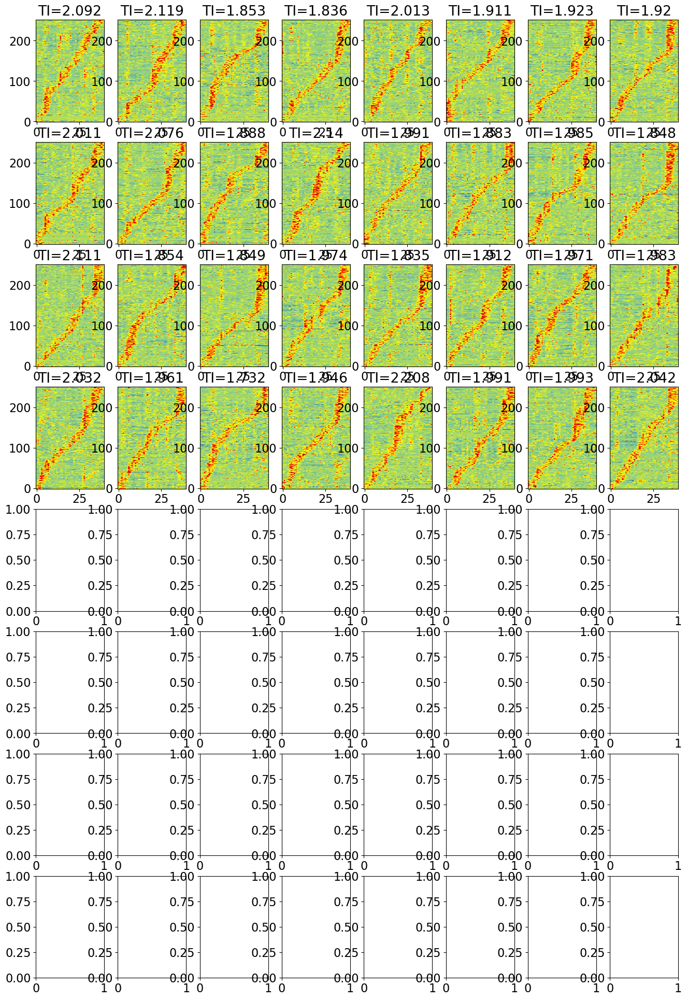

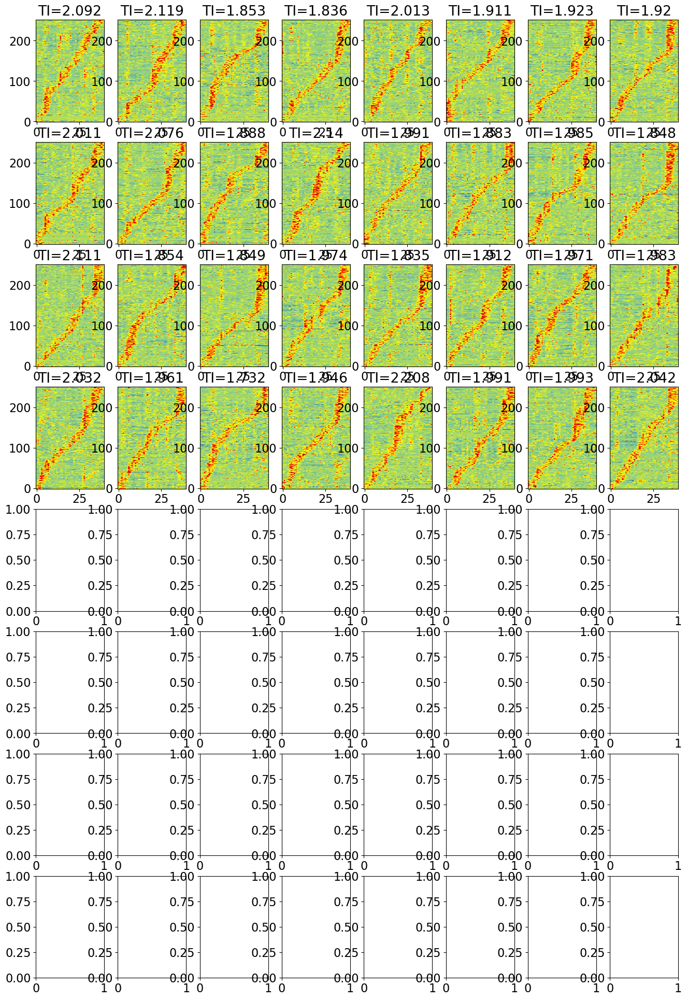

In [56]:
f = h5py.File(data_files[trained_sessions[10]], 'r')
trials = f['Trials']
fr_data = f['FR_All']
correct_trials = get_correct_trials(trials, 6)
print(f"# correct trials: {len(correct_trials)}")
if len(correct_trials) > 32:
    correct_trials = correct_trials[:32]
neurons = get_memory_selective_neurons(trials, fr_data)
print(f"# memory-selective neurons: {len(neurons)}")
animal_activity_heat_maps(fr_data, correct_trials, neurons, delay=6, sr=4)

#### Plot some sample trials for the paper

# correct trials: 73
# memory-selective neurons: 252


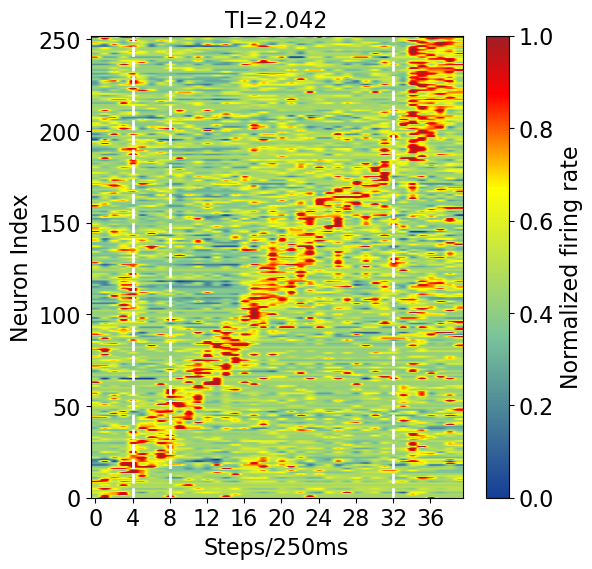

In [57]:
f = h5py.File(data_files[trained_sessions[10]], 'r')
trials = f['Trials']
fr_data = f['FR_All']
correct_trials = get_correct_trials(trials, 6)
print(f"# correct trials: {len(correct_trials)}")
neurons = get_memory_selective_neurons(trials, fr_data)
print(f"# memory-selective neurons: {len(neurons)}")
fig = animal_activity_heat_map(fr_data, correct_trials[31], neurons, delay=6, sr=4)
fig.savefig("sample_animal.svg")

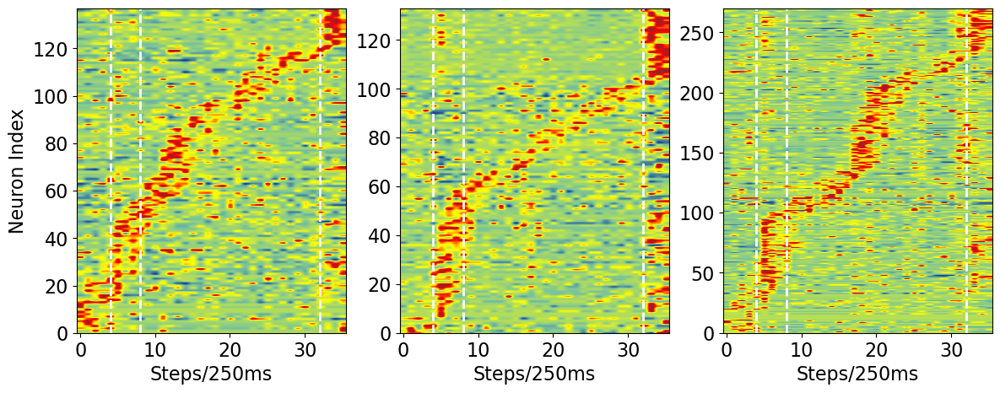

In [49]:
data = []
for i, t in zip([12, 7, 13], [5, 14, 0]):
    f = h5py.File(data_files[trained_sessions[i]], 'r')
    trials = f['Trials']
    fr_data = f['FR_All']
    correct_trials = get_correct_trials(trials, 6)
    neurons = get_memory_selective_neurons(trials, fr_data)
    data.append(fr_data[:, neurons, correct_trials[t]])
f = combined_heat_maps(data, t_begin=2, delay=6, sr=4)
f.savefig("more_animal_samples.svg")

In [36]:
fr_data.shape

(56, 312, 240)

#### Calculate TIs of recordings from animal experiments.
- Trials with 6 s of delays.
- Filter trained sessions with higher than 75% accuracies in the first 120 trials (because animal gets tired during the session and the performance decrease).
- Only use correct trials.
- Calculate TIs for individual trials, and average for each session. 1 session = 1 trained model.

In [13]:
data_files = glob.glob("/home/jiashuncheng/liuchenghao/transient_data/SPKINFO/*/*/FR_All_ 250.hdf5")
accuracies = []
for data_file in data_files:
    f = h5py.File(data_file, 'r')
    trials = f['Trials']
    # Since it was said that later trials tend to have lower accuracies
    # Filter session based on their accuracies in the first half of the trials (120)
    accuracies.append(session_accuracy(trials, 6))
session_acc_th = 0.85
trained_sessions = np.nonzero(np.array(accuracies) > session_acc_th)[0]
trained_session_files = [data_files[s] for s in trained_sessions]
print(f"# trained session: {len(trained_sessions)}")
animal_TIs = animalGetMeanTIs(trained_session_files, memory_neurons=True)

# trained session: 14


In [70]:
np.mean(animal_TIs)

1.9230734515972219

In [76]:
animal_TIs

[1.8437321428571427,
 1.9568938053097347,
 1.8882452830188678,
 1.939867924528302,
 1.9229904761904764,
 1.8559716981132075,
 1.8842980769230768,
 1.9424601769911503,
 1.9502260869565218,
 1.8415339805825242,
 1.8484716981132077,
 1.9220550458715595,
 1.7426057692307693,
 1.886895238095238]

In [75]:
np.nonzero(np.array(animal_TIs) > 1.9)

(array([ 1,  3,  4,  7,  8, 11]),)

#### Compare TIs of animals and models

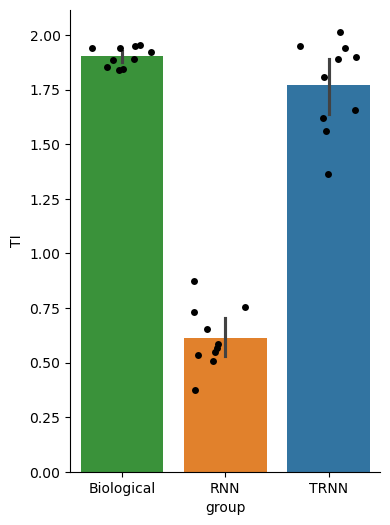

In [14]:
import seaborn as sb
from scipy import stats
import pandas as pd

df = pd.concat([pd.melt(pd.DataFrame({g: d}), var_name='group', value_name='TI') 
                for d, g in zip([animal_TIs[:10], RNN_TIs, TRNN_TIs], ['Biological', 'RNN', 'TRNN'])])
fig, ax = plt.subplots()
plt.rcParams.update({'font.size': 16})
sb.barplot(df, x="group", y="TI", hue="group", hue_order=['TRNN', 'RNN', 'Biological'], ax=ax)
sb.stripplot(df, x="group", y="TI", color='k', jitter=0.3, ax=ax)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
fig.set_size_inches(4, 6)
fig.savefig("ODPA_compare_TIs.svg")
df.to_csv("ODPA_compare_TIs.csv")

In [73]:
print(stats.ttest_ind(TRNN_TIs, animal_TIs))
print(stats.ttest_ind(TRNN_TIs, RNN_TIs))
print(stats.ttest_ind(animal_TIs, RNN_TIs))

Ttest_indResult(statistic=-1.9956297455995013, pvalue=0.058502528829632444)
Ttest_indResult(statistic=14.336987254392389, pvalue=2.7397741345984875e-11)
Ttest_indResult(statistic=30.003010921106522, pvalue=2.4225377000071463e-19)
